NOTE: This notebook is set up for a google colab environment

- make sure PIL is updated to version 9.3.0, this might require you to restart the run time

- also, cv2.imshow() is replaced with google colab's cv2_imshow() function, because cv2.imshow() tends to crash colab

In [ ]:
!pip3 install pillow==9.3.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# SETUP

## Install Libraries

In [ ]:
!pip3 install opencv-python --upgrade
!pip3 install imutils
!pip3 install scipy
!pip3 install kaggle

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Import Libraries

In [ ]:
# import the necessary packages
import numpy as np
import imutils
import time
from scipy import spatial
import cv2
import os
from google.colab.patches import cv2_imshow
import json
import glob
from PIL import ImageFont, ImageDraw, Image

## Download Resources and Format Directory

In [ ]:
!mkdir ~/.kaggle
!touch ~/.kaggle/kaggle.json

api_token = {"username":"amyconradie","key":"177046d0c40e7831e24838df7885baf4"}

with open('/root/.kaggle/kaggle.json', 'w') as file:
    json.dump(api_token, file)

!chmod 600 ~/.kaggle/kaggle.json

# download dataset
!kaggle datasets download -d landrykezebou/vriv-vehicle-recognition-in-videos-dataset # sownload VRiV
!unzip '/content/vriv-vehicle-recognition-in-videos-dataset' -d "/content/inputVideos" "*.mp4" "*.MOV" # only load mp4 and MOV files
!rm '/content/vriv-vehicle-recognition-in-videos-dataset.zip'
!mkdir 'outputVideos' # create output directory

# download yolo model data
!wget https://raw.githubusercontent.com/pjreddie/darknet/master/cfg/yolov3.cfg
!wget https://pjreddie.com/media/files/yolov3.weights
!wget https://raw.githubusercontent.com/pjreddie/darknet/master/data/coco.names

# download font
!wget https://github.com/rsms/inter/archive/refs/heads/master.zip
!unzip -j '/content/master' -d "/content/fonts" "*.ttf" # only load ttf files
!mv /content/fonts/Inter.var.ttf /content/fonts/Inter.ttf
!rm '/content/master.zip'

 99% 2.19G/2.22G [00:12<00:00, 259MB/s]
100% 2.22G/2.22G [00:12<00:00, 187MB/s]
Archive:  /content/vriv-vehicle-recognition-in-videos-dataset.zip
  inflating: /content/inputVideos/BMW_320I_2018_black_1.MOV  
  inflating: /content/inputVideos/BMW_320I_2018_black_2.MOV  
  inflating: /content/inputVideos/BMW_320I_2018_black_3.MOV  
  inflating: /content/inputVideos/Honda Odyssey 2012_silver.mp4  
  inflating: /content/inputVideos/Honda_Civic_2019_gray_1.MOV  
  inflating: /content/inputVideos/Honda_Civic_2019_gray_2.MOV  
  inflating: /content/inputVideos/Nissan Versa_2011_Grey_01.mp4  
  inflating: /content/inputVideos/Nissan Versa_2011_Grey_02.mp4  
  inflating: /content/inputVideos/Nissan_altima_2013_black_01.mp4  
  inflating: /content/inputVideos/Nissan_altima_2013_black_02.mp4  
  inflating: /content/inputVideos/Nissan_versa_2010_silver.mp4  
  inflating: /content/inputVideos/Toyota_Corolla 2004_red_01.mp4  
  inflating: /content/inputVideos/Toyota_Corolla 2004_red_02.mp4  
  infla

# DETECTOR CLASS

In [ ]:
class Yolo3_ObjectDetector:

    def __init__(self):

        # dnn input parameters
        self.n_frames_prior = 10 # check the N frames before this one, for each box
        self.input_width, self.input_height = 416, 416 # what size input to put in the model
        self.minimum_confidence = 0.5 # filter boxes by score
        self.non_max_threshold = 0.3 # used for non-max suppression

        # load all class names
        with open('coco.names') as f:
            self.class_labels = [line.rstrip('\n') for line in f]

        # specify vehicle classes
        self.list_of_vehicles = ["bicycle","car","motorbike","bus","truck", "train"]

        # get pre trained weights and config files
        self.weightsPath = 'yolov3.weights'
        self.configPath = 'yolov3.cfg'

        # load fonts
        self.fontPath = "./fonts/Inter.ttf"     

        # Initialize a list of colors to represent each possible class label
        self.class_colors = np.random.randint(0, 255, size=(len(self.class_labels), 3), dtype="uint8")

        # load our YOLO object detector trained on COCO dataset (80 classes)
        # and determine only the *output* layer names that we need from YOLO
        self.net = cv2.dnn.readNetFromDarknet(self.configPath, self.weightsPath)

        # use GPU
        self.net.setPreferableBackend(cv2.dnn.DNN_BACKEND_CUDA)
        self.net.setPreferableTarget(cv2.dnn.DNN_TARGET_CUDA)

        # get unconnected layer names
        self.layer_names = self.net.getLayerNames()
        self.layer_names = [self.layer_names[i - 1] for i in self.net.getUnconnectedOutLayers()]

        self.inputVideoPath = "inputVideos"
        self.outputVideoPath = "outputVideos"

    
    # See if this box was in the previous N frames
    def CheckPreviousFramesForBox(self, current_box, current_detections):

        # get coords
        center_x, center_y, w, h = current_box

        # set current distance to minimum distance
        current_dist = np.inf

        # Iterating through all the k-dimensional trees
        for i in range(self.n_frames_prior):

            # get list of previous box coords
            coordinate_list = list(self.previous_frame_detections[i].keys())

            # if no other detections present in the previous frame, continue
            if len(coordinate_list) == 0: 
                continue

            # find distance to closest point and closest index
            temp_dist, idx = spatial.KDTree(coordinate_list).query([(center_x, center_y)])

            # if frame i contains this box
            if (temp_dist < current_dist):
                current_dist = temp_dist
                frame_idx = i
                coord = coordinate_list[idx[0]]
        
        # if current distance is greater than half the maximum possible distance,
        # this box was not present in the past n frames
        if (current_dist > (max(w, h) * 0.5)):
            return False

        # if the box was present in the last n frame 
        current_detections[(center_x, center_y)] = self.previous_frame_detections[frame_idx][coord]
        return True


    # adds text to images
    def DrawText(self, img, text, pos, font_path, font_size, text_color, pos_adjustment = (0, 0), stroke_width = 0, bg_color = None, padding = (7,10), bg_outline_thickness = 10):
        
        # load font
        font = ImageFont.truetype(font_path, font_size)

        # convert from cv2 to PIL
        img = np.array(img) 
        img_pil = Image.fromarray(img)

        # create drawable object
        draw = ImageDraw.Draw(img_pil, "RGBA")

        # get text size
        tx, ty, w, h = draw.textbbox(pos, text, font = font)

        # add pos adjustments
        pos = (pos[0] + pos_adjustment[0], pos[1] + pos_adjustment[1])

        # save text box size
        textbox_size = (abs(tx - w), abs(ty - h))

        # create BG for textbox
        if bg_color != None:
            
            # get padding values
            padding_x, padding_y = padding

            # get text size
            _, _, w, h = draw.textbbox(pos, text, font = font)

            # expand position
            x, y = pos
            
            # add padding to bg
            bgw, bgh = (w + (padding_x*2), h + (padding_y*2)) 

            # draw bg on image before text is added
            draw.rectangle((x, y, bgw, bgh), fill = bg_color, outline = bg_color, width = bg_outline_thickness) 

            # draw textbox on to image
            draw.text((x + padding_x, y + ((bgh - h)*0.5)), text, font = font, fill =text_color, stroke_width = stroke_width, stroke_fill = text_color)
            
            # save text box size
            textbox_size = (abs(x - bgw), abs(y - bgh)) 
        else:
            # draw textbox on to image
            draw.text(pos, text, font = font, fill = text_color, stroke_width = stroke_width, stroke_fill = text_color)

        # convert from PIL to np
        img = np.array(img_pil)

        return img, textbox_size


    # Draw all the detection boxes with a green dot at the center
    def DrawBoundingBoxes(self, idxs, boxes, class_IDs, confidence_scores, frame):

        # if at least 1 detection
        if len(idxs) > 0:
            
            # loop through detection indices
            for i in idxs.flatten():

                # get bbox coords
                x, y, w, h = boxes[i][0], boxes[i][1], boxes[i][2], boxes[i][3]

                # get class color
                color = [int(color) for color in self.class_colors[class_IDs[i]]]

                # draw bbox
                cv2.rectangle(frame, (x, y), (x + w, y + h), color, 2)

                # create label
                label = self.class_labels[class_IDs[i]] + ": " + str(round(confidence_scores[i], 2))

                # draw text onto frame
                temp = frame
                temp, textbox_size = self.DrawText(img = temp, text = label, pos=(x, y), font_path = self.fontPath, font_size = 12, text_color = (255,255,255), bg_color = tuple(color), padding = (5,2))
                frame, _ = self.DrawText(img = frame, text = label, pos=(x, y), pos_adjustment = (- textbox_size[0]*0.01, - textbox_size[1]), font_path = self.fontPath, font_size = 12, text_color = (255,255,255), bg_color = tuple(color), padding = (5,2))

        return frame


    # counts numbers of vehicles
    def CountDetections(self, idxs, boxes, class_IDs, frame):
        
        # current_detections = {}
        current_vehicle_detections = {}
        current_other_detections = {}

        # ensure at least one detection exists
        if len(idxs) > 0:

            # loop over the indices we are keeping
            for i in idxs.flatten():

                # extract the bounding box coordinates
                x, y, w, h = boxes[i][0], boxes[i][1], boxes[i][2], boxes[i][3]
                center_x = x + (w//2)
                center_y = y + (h//2)

                # track other objects recognised in the scene
                if (self.class_labels[class_IDs[i]] not in self.list_of_vehicles):

                    # get list of non vehicle items that are in the frame
                    current_other_detections[(center_x, center_y)] = self.other_count 

                    # see if this box was in a previous frame and if not count it as a new item
                    if (not self.CheckPreviousFramesForBox((center_x, center_y, w, h), current_other_detections)):
                        self.other_count += 1

                    # Get the ID of the current detection
                    ID = current_other_detections.get((center_x, center_y))

                    # If there are two detections having the same ID due to being too close, then assign a new ID to current detection.
                    if (list(current_other_detections.values()).count(ID) > 1):
                        current_other_detections[(center_x, center_y)] = self.other_count
                        self.other_count += 1 

                    # get class color
                    color = [int(color) for color in self.class_colors[class_IDs[i]]]

                    #Display the ID at the center of the box
                    temp = frame
                    temp, textbox_size = self.DrawText(img = temp, text = "Item " + str(ID), pos=(x + w, y), pos_adjustment = (0, 0), font_path = self.fontPath, font_size = 12, text_color = (255,255,255), bg_color = tuple(color), padding = (5,2))
                    frame, _ = self.DrawText(img = frame, text = "Item " + str(ID), pos=(x + w, y), pos_adjustment = (0, -textbox_size[1]*0.001), font_path = self.fontPath, font_size = 12, text_color = (255,255,255), bg_color = tuple(color), padding = (5,2))

                # When the detection is in the list of vehicles, AND it crosses the line AND the ID of the detection is not present in the vehicles
                elif (self.class_labels[class_IDs[i]] in self.list_of_vehicles):

                    # get list of vehicles counted in the frame
                    current_vehicle_detections[(center_x, center_y)] = self.vehicle_count 

                    # if any of the vehicles in the frame are not in previous frames, count that vehicle as a new item
                    if (not self.CheckPreviousFramesForBox((center_x, center_y, w, h), current_vehicle_detections)):
                        self.vehicle_count += 1

                    # Get the ID corresponding to the current detection
                    ID = current_vehicle_detections.get((center_x, center_y))

                    # if there are two detections having the same ID due to being too close, then assign a new ID to current detection.
                    if (list(current_vehicle_detections.values()).count(ID) > 1):
                        current_vehicle_detections[(center_x, center_y)] = self.vehicle_count
                        self.vehicle_count += 1 

                    # get class color
                    color = [int(color) for color in self.class_colors[class_IDs[i]]]

                    # display the ID at the center of the box
                    temp = frame
                    temp, textbox_size = self.DrawText(img = temp, text = "Item " + str(ID), pos=(x + w, y), pos_adjustment = (0, 0), font_path = self.fontPath, font_size = 12, text_color = (255,255,255), bg_color = tuple(color), padding = (5,2))
                    frame, _ = self.DrawText(img = frame, text = "Item " + str(ID), pos=(x + w, y), pos_adjustment = (0, -textbox_size[1]*0.001), font_path = self.fontPath, font_size = 12, text_color = (255,255,255), bg_color = tuple(color), padding = (5,2))

        # return detection counts and current_detections
        return frame, current_vehicle_detections, current_other_detections 


    def CreateVideoWriter(self, file_name, extension):
        # create vidoe stream
        self.videoStream = cv2.VideoCapture(self.inputVideoPath + "/" + file_name + extension)

        # set video width and height
        self.video_width = int(self.videoStream.get(cv2.CAP_PROP_FRAME_WIDTH))
        self.video_height = int(self.videoStream.get(cv2.CAP_PROP_FRAME_HEIGHT))

        # create video writer
        self.video_writer = cv2.VideoWriter(self.outputVideoPath + "/" + file_name + ".avi", cv2.VideoWriter_fourcc(*"MJPG"), self.videoStream.get(cv2.CAP_PROP_FPS), (self.video_width, self.video_height), True)


    def ProcessVideo(self, file_name, extension, show_images = True):

        # create video stream and video writer
        self.CreateVideoWriter(file_name, extension)

        # create a list detections so that the yolo model can reference previous detection
        self.previous_frame_detections = [{(0,0):0} for i in range(self.n_frames_prior)]

        # counters
        self.vehicle_count = 0
        self.other_count = 0

        # loop over all frames in video file
        while True:

            # make lists for boxes, scores and indices
            boxes, confidences, class_IDs = [], [], [] 

            # get next frame from video
            (grabbed, frame) = self.videoStream.read()

            # if frame not grabbed, then video is finished
            if not grabbed:
                break

            # make blob from input frame
            blob = cv2.dnn.blobFromImage(frame, 1 / 255.0, (self.input_width, self.input_height), swapRB=True, crop=False)

            # do a forward pass of the YOLO object detector
            self.net.setInput(blob)

            # get bounding boxes and predictions
            layer_outputs = self.net.forward(self.layer_names)

            # loop over each of the layer outputs
            for output in layer_outputs:

                # loop over each of the detections
                for i, detection in enumerate(output):

                    # extract the class ID and confidence (i.e., probability)
                    # of the current object detection
                    scores = detection[5:]
                    class_ID = np.argmax(scores)
                    confidence = scores[class_ID]

                    # filter out weak predictions by ensuring the detected probability is greater than the minimum probability
                    if confidence > self.minimum_confidence:

                        # scale the bounding box coordinates back relative to
                        # the size of the image, keeping in mind that YOLO
                        # actually returns the center (x, y)-coordinates of
                        # the bounding box followed by the boxes' width and
                        # height
                        box = detection[0:4] * np.array([self.video_width, self.video_height, self.video_width, self.video_height])
                        center_x, center_y, w, h = box.astype("int")

                        # use the center coordinates to get top left corner of bounding box
                        x = int(center_x - (w / 2))
                        y = int(center_y - (h / 2))
    
                        # update our list of bounding box coordinates, confidences, and class IDs
                        boxes.append([x, y, int(w), int(h)])
                        confidences.append(float(confidence))
                        class_IDs.append(class_ID)

            # non-maxima suppression to suppress weak/overlapping bounding boxes
            idxs = cv2.dnn.NMSBoxes(boxes, confidences, self.minimum_confidence, self.non_max_threshold)

            # draw bounding box 
            frame = self.DrawBoundingBoxes(idxs, boxes, class_IDs, confidences, frame)

            # count detections
            frame, current_vehicle_detections, current_other_detections = self.CountDetections(idxs, boxes, class_IDs, frame)

            # display counts
            frame, textbox_size = self.DrawText(img = frame, text = 'Detected Vehicles: ' + str(self.vehicle_count), pos = (5, 5), font_path = self.fontPath, font_size = 18, text_color = (255, 255, 255), bg_color = (0,0,0,200))
            frame, _ = self.DrawText(img = frame, text = 'Other Detections: ' + str(self.other_count), pos = (5, 5), pos_adjustment = (0, textbox_size[1] + (textbox_size[1]*0.1)), font_path = self.fontPath, font_size = 18, text_color = (255, 255, 255), bg_color = (0,0,0,200))

            # write the output frame to disk
            self.video_writer.write(frame)

            # cv2.imshow('Frame', frame) # disabled in colab because it tends to crash
            cv2_imshow(frame) # switch to above if not using colab
            
            # Updating with the current frame detections
            self.previous_frame_detections.pop(0) #Removing the first frame from the list

            # previous_frame_detections.append(spatial.KDTree(current_detections))
            current_detections = {**current_vehicle_detections, **current_other_detections}
            self.previous_frame_detections.append(current_detections)

        # release the file pointers
        print("Releasing Video...")
        self.video_writer.release()
        self.videoStream.release()

    def ProcessVideoDirectory(self):
        # process all videos in directory
        for file in glob.glob("/content/" + self.inputVideoPath + "/*.*"):
            file_name, delim, extension = file.replace("/content/" + self.inputVideoPath + "/", "").rpartition('.')
            print("Processing: " + file_name + delim + extension)
            self.ProcessVideo(file_name, delim + extension)
            print("Finished Processing: " + file_name + delim + extension + "\n\n")

# RUN DETECTION ON VIDEO FILES

Processing: BMW_320I_2018_black_2.MOV


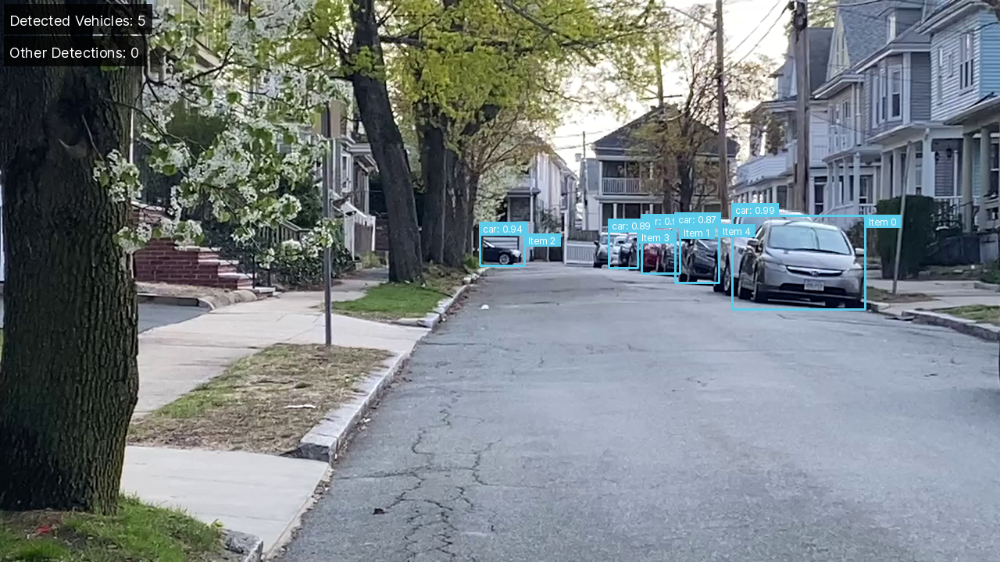

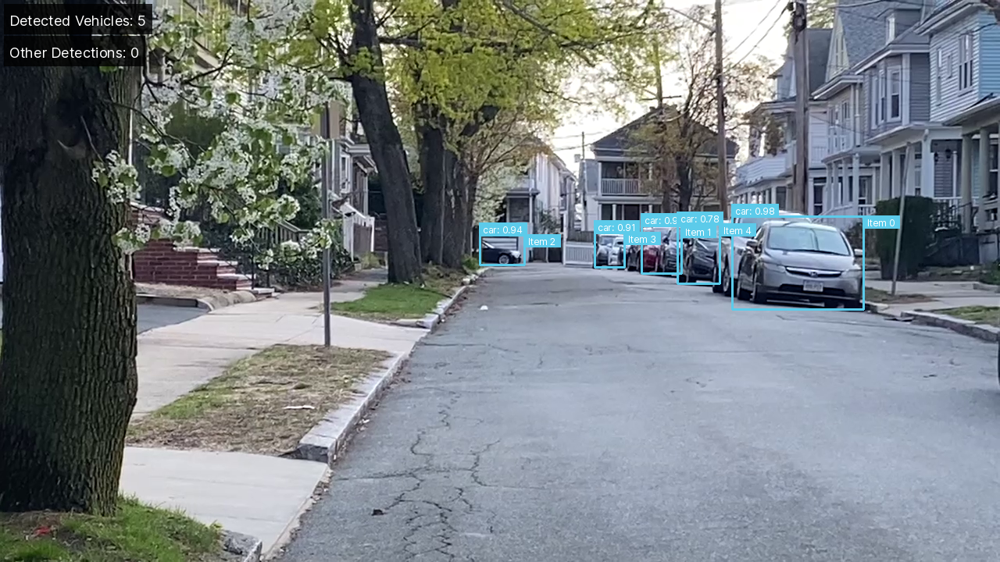

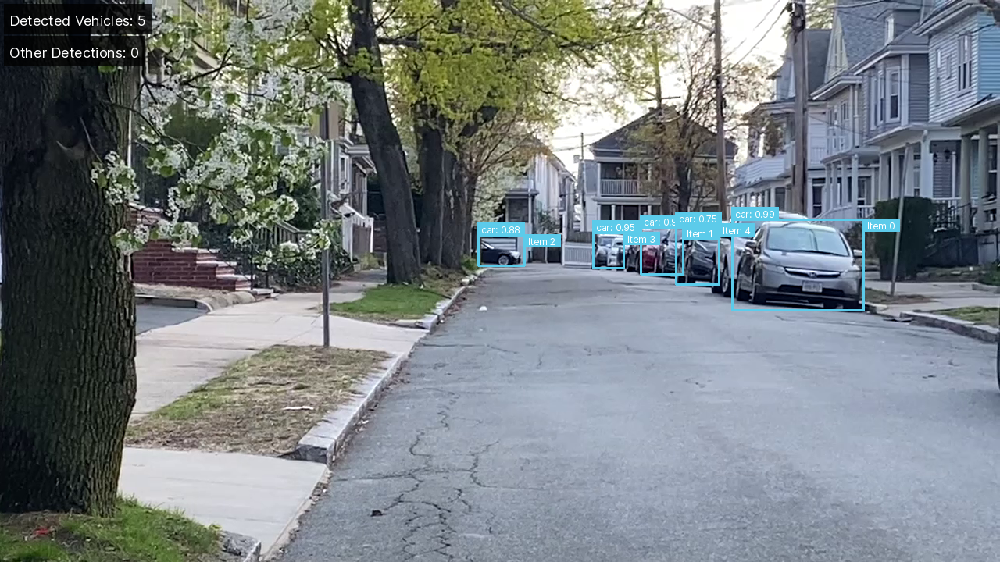

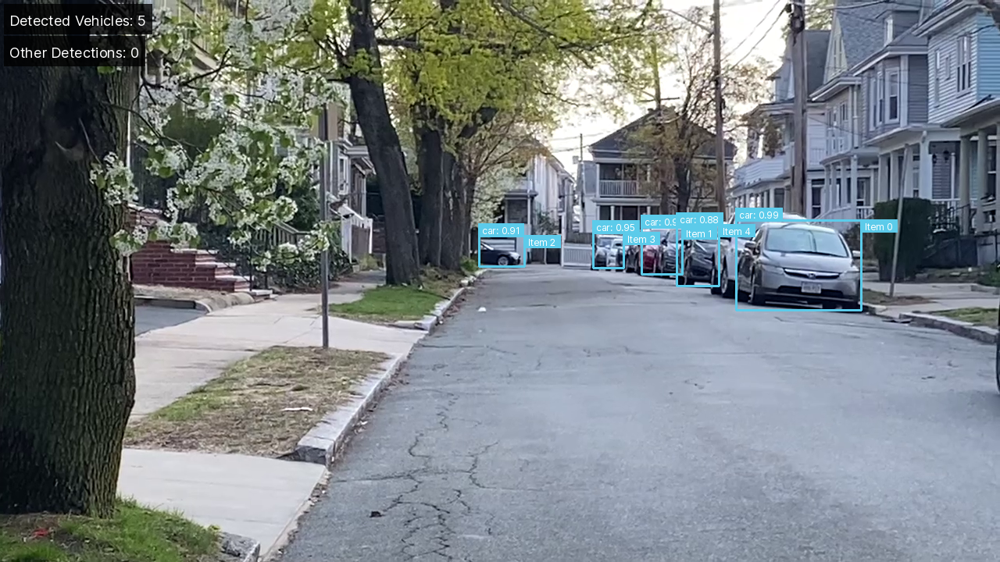

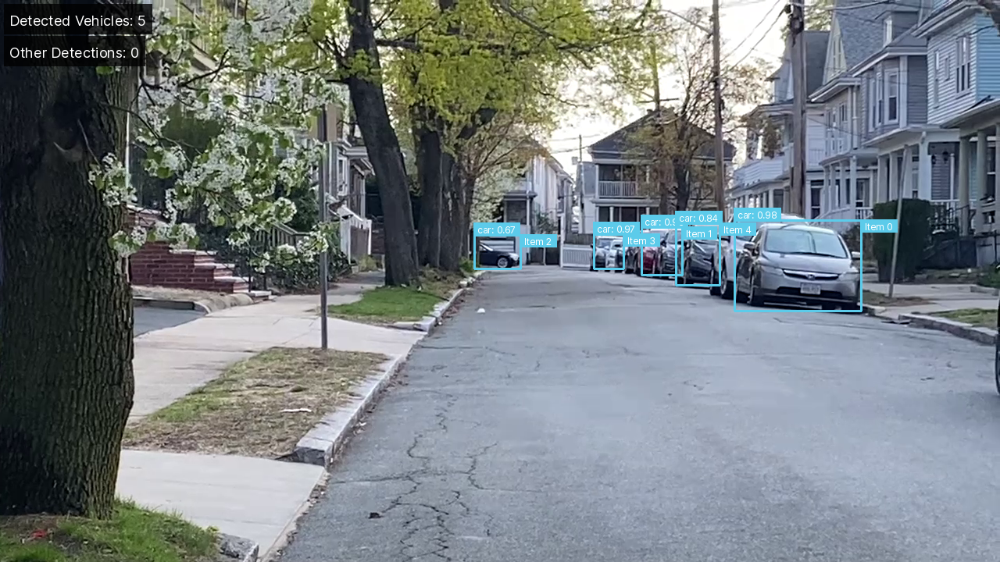

...

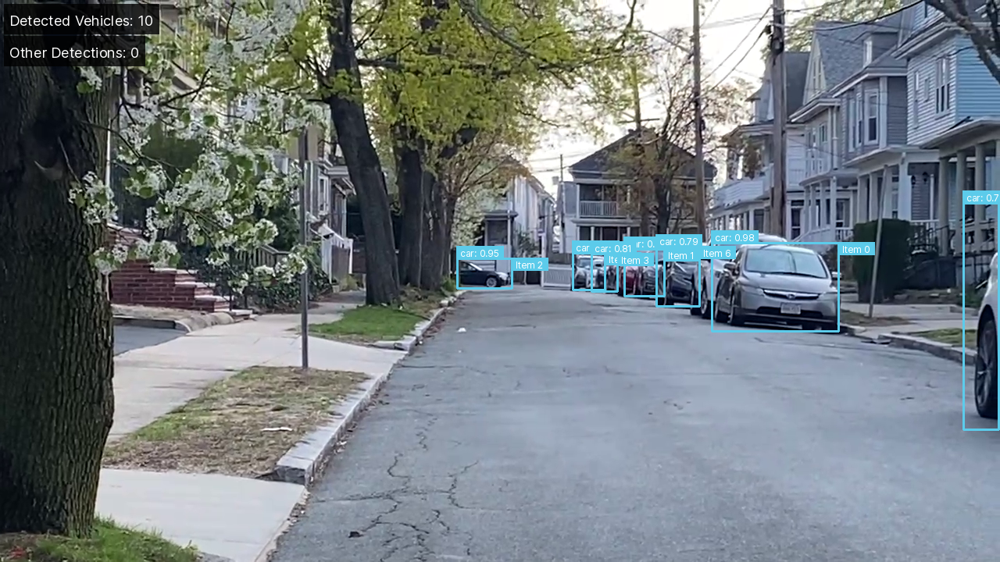

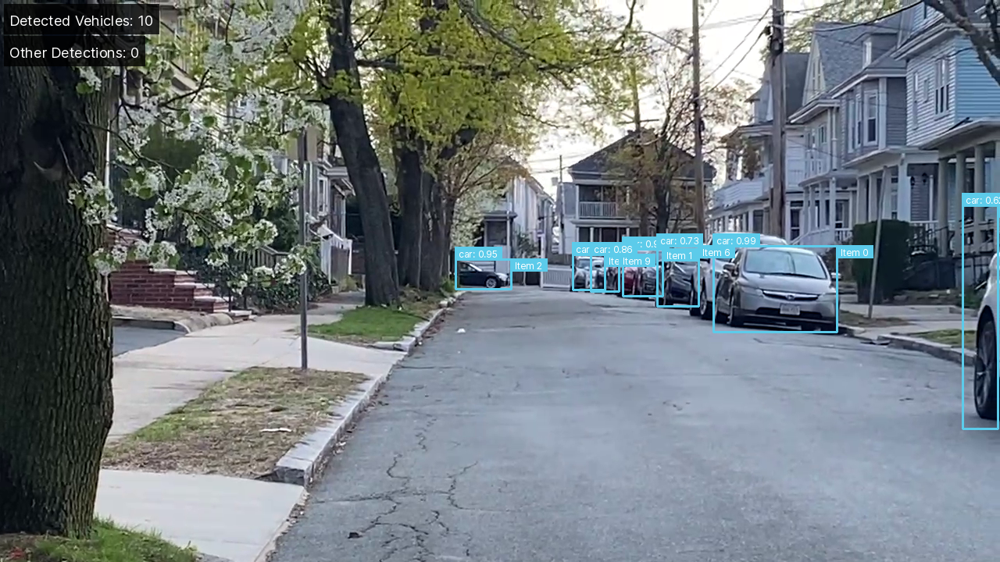

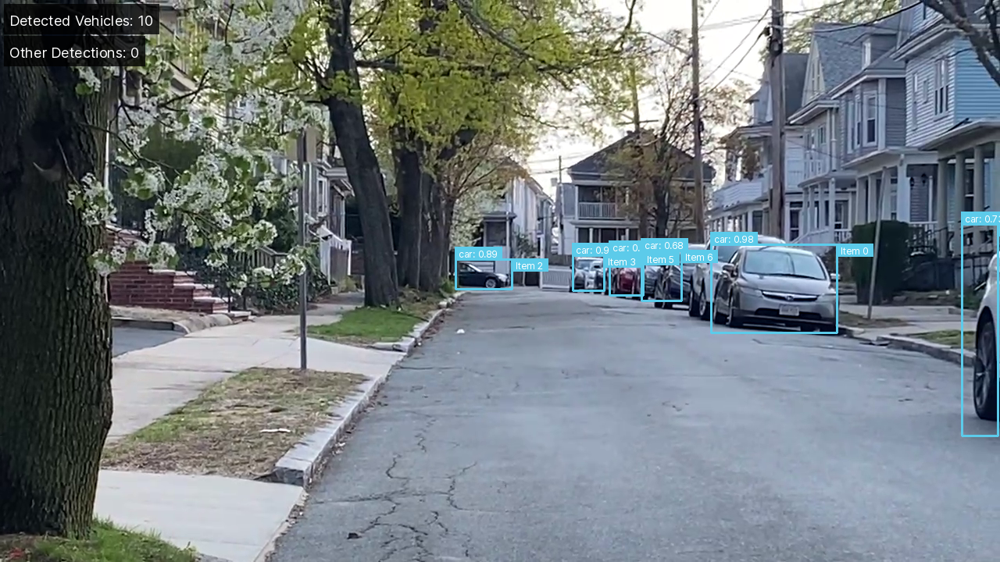

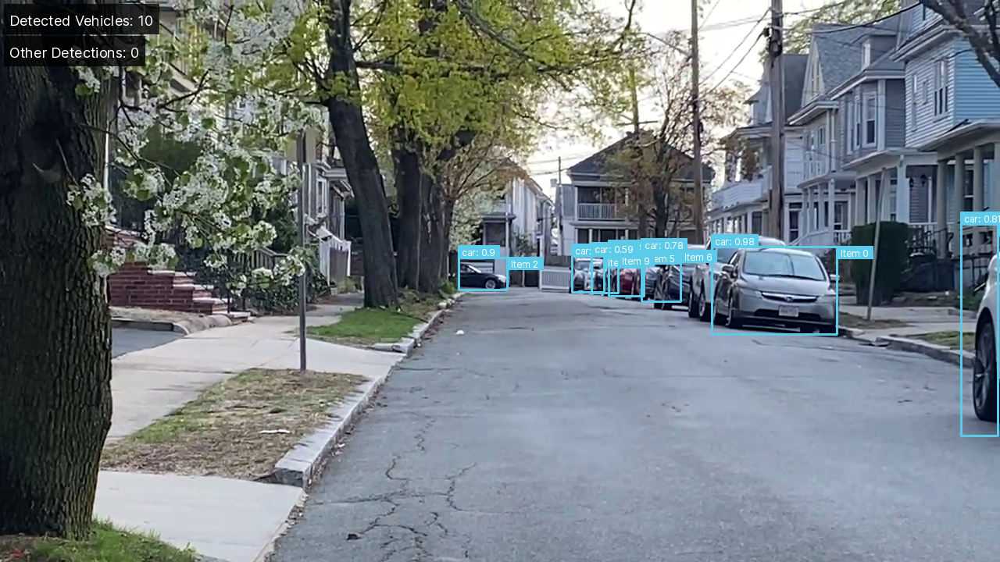

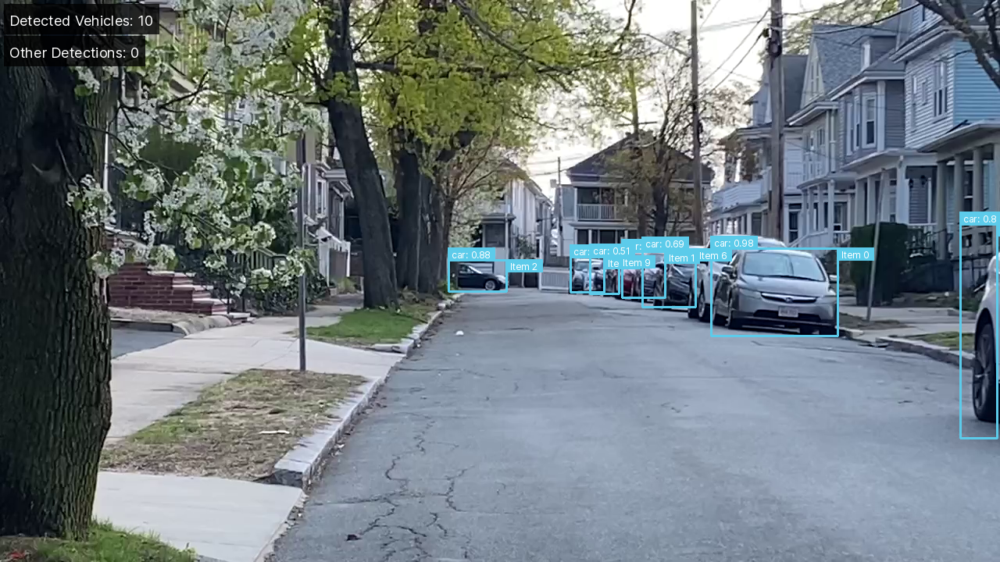

Buffered data was truncated after reaching the output size limit.

In [ ]:
np.random.seed(42)
yolo3 = Yolo3_ObjectDetector()
# yolo3.ProcessVideo("BMW_320I_2018_black_1",".MOV")
yolo3.ProcessVideoDirectory()